### Import

In [19]:
import pandas as pd
import numpy as np
import pickle
import json
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import layers, regularizers
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau,ModelCheckpoint

from sklearn.model_selection import train_test_split

import re
import nltk 
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from collections import Counter

import time
from joblib import Parallel,delayed


In [2]:
df = pd.read_csv('augmented_disease_dataset.csv')
df

,Code,Name,Symptoms,Symptom Sentences
0,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Fear of losing control, Trembling..."
1,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Palpitations, Trembling, Shortnes..."
2,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Shortness of breath, Sweating, an..."
3,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Sweating, Dizziness, Fear of losi..."
4,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Dizziness, and sometimes Palpitat..."
...,...,...,...,...
399995,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Slow healing of wounds, and somet..."
399996,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Fatigue, Increased hunger, and so..."
399997,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience , and sometimes Slow healing of w..."
399998,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Increased hunger, Fatigue, and so..."


### Preprocessing Data Function

In [21]:
# Remove unnecessary symbols, enter, spaces
def cleaningText(text):
    text = re.sub(r'[0-9]+', '', text) 
    text = re.sub(r"(\w)'(\w)", r"\1 \2", text)
    text = re.sub(r'[^\w\s]', '', text)

    text = text.replace('\n', ' ') 
    text = text.strip(' ') 
    return text   

# Lowercase the text
def casefoldingText(text): 
    text = text.lower()
    return text

# Tokenize the text
def tokenizingText(text): 
    text = word_tokenize(text)
    return text

# Remove frequent words and expected frequent words
def deletedfrequentWord(text):
    words_to_remove = {"sometimes","experience","experiencing","symptoms", 
                       "frequent", "feel", "felt","feeling", "suffer", 
                       "notice", "detect", "perceive", "indication"
                       "occasionally","usually","often","always","irregularly"
                       "periodically", "discountinuously", "rarely", "frequently"
                       "started","today","day","yesterday","monday","tuesday","wednesday"
                       "thursday","friday","saturday","sunday","last","dawn","morning"
                       "afternoon","evening","night","midnight","thank","since","doctor","nurse"}
    
    filtered_text = [word for word in text if word not in words_to_remove]
    
    return filtered_text

# Remove stopwords and return in form of string
def filteringText1(text): 
    listStopwords1 = set(stopwords.words('english'))  
    filtered = [txt for txt in text if txt not in listStopwords1]  
    return ' '.join(filtered)  

#Remove stopwords and return in form of list
def filteringText2(text): 
    listStopwords1 = set(stopwords.words('english'))  
    filtered = [txt for txt in text if txt not in listStopwords1]  
    return filtered

#Lemmatize the text (to change word into basic word)
def lemmatizeText(text):
    lemmatizer = WordNetLemmatizer()
    words = text.split()
    lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
    lemmatized_text = ' '.join(lemmatized_words)
    return lemmatized_text

#To count frequency of word
def countWordFrequencies(tokens):
    word_frequencies = Counter(tokens)
    return word_frequencies

### Looking for frequent words that are unnecessary

In [ ]:
#Preprocess to find frequent words
cleaned_text = df['Symptom Sentences'].apply(cleaningText)
casefolded_text = cleaned_text.apply(casefoldingText)
tokens = casefolded_text.apply(tokenizingText)
filtered_tokens = tokens.apply(filteringText2)

# Count word frequencies
word_frequencies = filtered_tokens.apply(countWordFrequencies)

In [ ]:
all_tokens = [word for row in filtered_tokens for word in row]

# Count word frequencies across the entire dataset
word_frequencies = Counter(all_tokens)

print("Most Frequent Words Across All Rows:", word_frequencies.most_common(25))

Most Frequent Words Across All Rows: [('experience', 400000), ('sometimes', 374000), ('pain', 116308), ('swelling', 49112), ('fatigue', 45107), ('loss', 38425), ('difficulty', 30131), ('vision', 26485), ('skin', 26034), ('fever', 23278), ('blood', 23038), ('nausea', 22542), ('abdominal', 21997), ('bleeding', 21968), ('changes', 19807), ('chest', 18401), ('weight', 18008), ('severe', 17295), ('vomiting', 17237), ('breath', 16798), ('weakness', 16680), ('eye', 16144), ('discomfort', 15696), ('shortness', 15620), ('symptoms', 15345)]


### Preprocessing Dataset

In [ ]:
#Preprocess for all entire dataset
df['text_clean'] = df['Symptom Sentences'].apply(cleaningText)

df['text_casefoldingText'] = df['text_clean'].apply(casefoldingText)

df['text_tokenizingText'] = df['text_casefoldingText'].apply(tokenizingText)

In [ ]:
#Preprocess for all entire dataset and save it in form of csv
def process_batch (df) :
    df['text_deletedfrequentWord'] = df['text_tokenizingText'].apply(deletedfrequentWord)
    
    df['text_stopword'] = df['text_deletedfrequentWord'].apply(filteringText1)

    df['text_lemmatizing'] = Parallel(n_jobs=-1)(delayed(lemmatizeText)(text) for text in df['text_stopword'])
    
    return df

start_time = time.time()
processed_df = process_batch(df)
end_time = time.time()

print(f"Total processing time : {(end_time - start_time) / 60:.2f} minutes")

processed_df.to_csv('preprocessed_augmented_disease_dataset.csv', index=False)  


Total processing time : 2.59 minutes


In [6]:
preprocessed_df = pd.read_csv('preprocessed_augmented_disease_dataset.csv')
preprocessed_df

,Code,Name,Symptoms,Symptom Sentences,text_clean,text_casefoldingText,text_tokenizingText,text_deletedfrequentWord,text_stopword,text_lemmatizing
0,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Fear of losing control, Trembling...",I experience Fear of losing control Trembling ...,i experience fear of losing control trembling ...,"['i', 'experience', 'fear', 'of', 'losing', 'c...","['i', 'fear', 'of', 'losing', 'control', 'trem...",fear losing control trembling shortness breath...,fear losing control trembling shortness breath...
1,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Palpitations, Trembling, Shortnes...",I experience Palpitations Trembling Shortness ...,i experience palpitations trembling shortness ...,"['i', 'experience', 'palpitations', 'trembling...","['i', 'palpitations', 'trembling', 'shortness'...",palpitations trembling shortness breath dizzin...,palpitation trembling shortness breath dizzine...
2,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Shortness of breath, Sweating, an...",I experience Shortness of breath Sweating and ...,i experience shortness of breath sweating and ...,"['i', 'experience', 'shortness', 'of', 'breath...","['i', 'shortness', 'of', 'breath', 'sweating',...",shortness breath sweating dizziness,shortness breath sweating dizziness
3,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Sweating, Dizziness, Fear of losi...",I experience Sweating Dizziness Fear of losing...,i experience sweating dizziness fear of losing...,"['i', 'experience', 'sweating', 'dizziness', '...","['i', 'sweating', 'dizziness', 'fear', 'of', '...",sweating dizziness fear losing control shortne...,sweating dizziness fear losing control shortne...
4,1,Panic disorder,"Palpitations, Sweating, Trembling, Shortness o...","I experience Dizziness, and sometimes Palpitat...",I experience Dizziness and sometimes Palpitations,i experience dizziness and sometimes palpitations,"['i', 'experience', 'dizziness', 'and', 'somet...","['i', 'dizziness', 'and', 'palpitations']",dizziness palpitations,dizziness palpitation
...,...,...,...,...,...,...,...,...,...,...
399995,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Slow healing of wounds, and somet...",I experience Slow healing of wounds and someti...,i experience slow healing of wounds and someti...,"['i', 'experience', 'slow', 'healing', 'of', '...","['i', 'slow', 'healing', 'of', 'wounds', 'and'...",slow healing wounds fatigue,slow healing wound fatigue
399996,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Fatigue, Increased hunger, and so...",I experience Fatigue Increased hunger and some...,i experience fatigue increased hunger and some...,"['i', 'experience', 'fatigue', 'increased', 'h...","['i', 'fatigue', 'increased', 'hunger', 'and',...",fatigue increased hunger slow healing wounds,fatigue increased hunger slow healing wound
399997,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience , and sometimes Slow healing of w...",I experience and sometimes Slow healing of wo...,i experience and sometimes slow healing of wo...,"['i', 'experience', 'and', 'sometimes', 'slow'...","['i', 'and', 'slow', 'healing', 'of', 'wounds']",slow healing wounds,slow healing wound
399998,400,Type 2 Diabetes,"Fatigue, Increased hunger, Slow healing of wounds","I experience Increased hunger, Fatigue, and so...",I experience Increased hunger Fatigue and some...,i experience increased hunger fatigue and some...,"['i', 'experience', 'increased', 'hunger', 'fa...","['i', 'increased', 'hunger', 'fatigue', 'and',...",increased hunger fatigue slow healing wounds,increased hunger fatigue slow healing wound


### Splitting Dataset

In [ ]:
#Split the data into 80% training dataset and 20% testing dataset
train,test = train_test_split(preprocessed_df, test_size=0.2,random_state=42,stratify=preprocessed_df['Code'])

In [ ]:
#Define the x_train, y_train, x_test, and y_test
x_train = train['text_lemmatizing']
y_train = train['Code']
x_test = test['text_lemmatizing']
y_test = test['Code']

### Tokenizer

In [ ]:
#Load tokenize
tokenizer = tf.keras.preprocessing.text.Tokenizer() 

In [ ]:
# Change x_train and x_test in type of string in a list
x_train = x_train.astype(str).tolist()
x_test = x_test.astype(str).tolist()

In [ ]:
#Fit the tokenizer to x_train
tokenizer.fit_on_texts(x_train)

In [ ]:
#Save the tokenizer in json file
tokenizer_json = tokenizer.to_json()
with open("tokenizer_disease.json", 'w') as json_file:
    json.dump(tokenizer_json, json_file)

### Padding sequence data

In [ ]:
# Convert x_train and x_test into sequences
x_train_seq = tokenizer.texts_to_sequences(x_train)
x_test_seq = tokenizer.texts_to_sequences(x_test)

# Pad the sequences to ensure they have same length
max_len = max(len(seq) for seq in x_train_seq) 
x_train_seqs_padded = pad_sequences(x_train_seq, maxlen=max_len, padding='post')
x_test_seqs_padded = pad_sequences(x_test_seq, maxlen=max_len, padding='post')


In [16]:
print(f"x_train shape: {x_train_seqs_padded.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"x_val shape: {x_test_seqs_padded.shape}")
print(f"y_val shape: {y_test.shape}")

x_train shape: (320000, 35)
y_train shape: (320000,)
x_val shape: (80000, 35)
y_val shape: (80000,)


### RNN Model

In [ ]:
# Model Definition
sequence_input = tf.keras.Input(shape=(35,), dtype="int32")

# Embedding Layer
embedded_sequences = layers.Embedding(
    input_dim=len(tokenizer.word_index) + 1,
    output_dim=300,
    input_length=35
)(sequence_input)

# Bidirectional LSTM
lstm_output = layers.Bidirectional(
    layers.LSTM(256, return_sequences=True)
)(embedded_sequences)

# Attention Mechanism
query = lstm_output  # Query from LSTM output
value = lstm_output  # Value from LSTM output
attention_output = layers.Attention()([query, value])

# Additional LSTM Layer
final_lstm_output = layers.Bidirectional(
    layers.LSTM(128, return_sequences=False)
)(attention_output)

# Batch Normalization
normalized_output = layers.BatchNormalization()(final_lstm_output)

# Dense Layers with Dropout
dense1 = layers.Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.01))(normalized_output)
dropout1 = layers.Dropout(0.4)(dense1)

dense2 = layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.01))(dropout1)
dropout2 = layers.Dropout(0.3)(dense2)

# Output Layer
output = layers.Dense(401, activation='softmax')(dropout2)

# Build Model
model = tf.keras.Model(inputs=sequence_input, outputs=output)

# Compile Model
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Model Summary
model.summary()


c:\Users\DARRELL\anaconda3\envs\ai-demo\Lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 35)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 35, 300)   │    271,800 │ input_layer[0][0] │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional       │ (None, 35, 512)   │  1,140,736 │ embedding[0][0]   │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attention           │ (None, 35, 512)   │          0 │ bidirectional[0]… │
│ (Attention)         │                   │            │ bidirectional[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_1     │ (None, 256)       │    656,384 │ attention[0][0]   │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256)       │      1,024 │ bidirectional_1[… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 512)       │    131,584 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 512)       │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 256)       │    131,328 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 256)       │          0 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 401)       │    103,057 │ dropout_1[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,435,913 (9.29 MB)

 Trainable params: 2,435,401 (9.29 MB)

 Non-trainable params: 512 (2.00 KB)

### Hyperparameter Tuning

In [ ]:
# Tuning learning rate until best model using early stopping and automatically save with model checkpoint
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)
model_checkpoint = ModelCheckpoint('trial.keras', save_best_only=True)


### Training Model

In [19]:
# Using tf.data for efficient handling of large datasets
train_dataset = tf.data.Dataset.from_tensor_slices((x_train_seqs_padded, y_train))
train_dataset = train_dataset.shuffle(buffer_size=10000).batch(128).prefetch(tf.data.AUTOTUNE)

val_dataset = tf.data.Dataset.from_tensor_slices((x_test_seqs_padded, y_test))
val_dataset = val_dataset.batch(128).prefetch(tf.data.AUTOTUNE)

# Model training
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=50,
    callbacks=[early_stopping, reduce_lr, model_checkpoint]
)


Epoch 1/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 524s 207ms/step - accuracy: 0.5242 - loss: 2.9978 - val_accuracy: 0.8412 - val_loss: 0.8416 - learning_rate: 0.0010
Epoch 2/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 491s 196ms/step - accuracy: 0.8275 - loss: 0.8909 - val_accuracy: 0.8563 - val_loss: 0.7215 - learning_rate: 0.0010
Epoch 3/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 492s 197ms/step - accuracy: 0.8447 - loss: 0.7711 - val_accuracy: 0.8661 - val_loss: 0.6715 - learning_rate: 0.0010
Epoch 4/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 493s 197ms/step - accuracy: 0.8520 - loss: 0.7193 - val_accuracy: 0.8652 - val_loss: 0.6584 - learning_rate: 0.0010
Epoch 5/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 494s 198ms/step - accuracy: 0.8559 - loss: 0.6867 - val_accuracy: 0.8690 - val_loss: 0.6151 - learning_rate: 0.0010
Epoch 6/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 492s 197ms/step - accuracy: 0.8569 - loss: 0.6788 - val_accuracy: 0.8692 - val_loss: 0.6111 - learning_rate: 0.0010
Epoch 7/50
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 497s 199ms

### Plotting

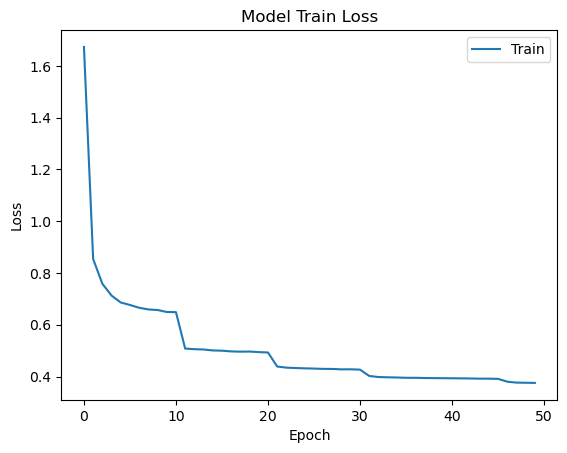

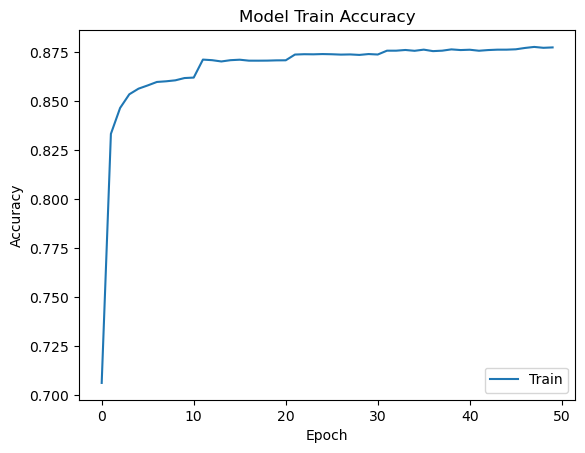

In [ ]:
#Plotting history train loss
plt.plot(history.history['loss'])
plt.title('Model Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train'],loc = 'upper right')
plt.show()

#Plotting history train accuracy
plt.plot(history.history['accuracy'])
plt.title('Model Train Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train'],loc = 'lower right')
plt.show()

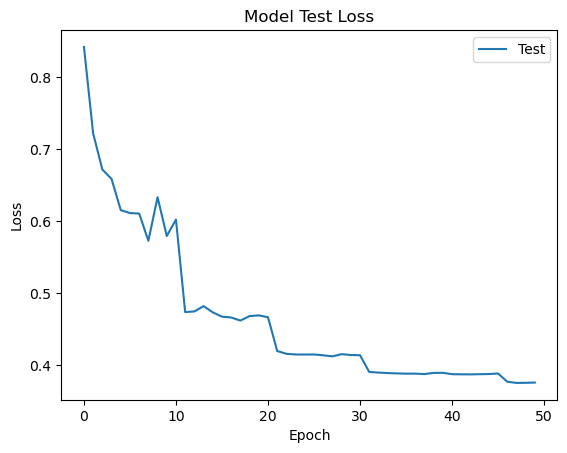

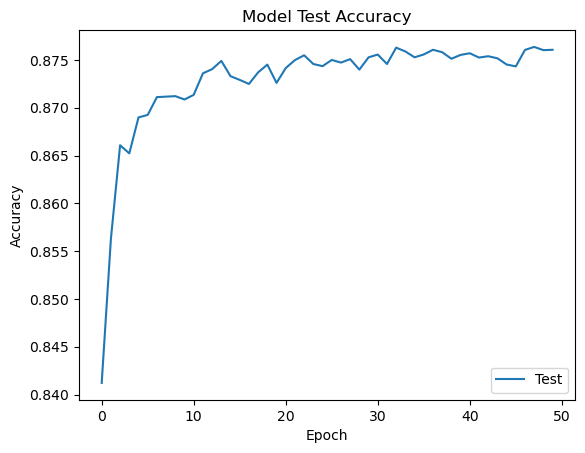

In [ ]:
#Plotting history test loss
plt.plot(history.history['val_loss'])
plt.title('Model Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Test'],loc = 'upper right')
plt.show()

#Plotting history test accuracy
plt.plot(history.history['val_accuracy'])
plt.title('Model Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Test'],loc = 'lower right')
plt.show()

## Testing

### Load Model

In [ ]:
new_model = tf.keras.models.load_model('best_model_predict_diseases.keras')

### Mapping

In [ ]:
#Get the disease name from code
mapping = {}
for i in range(0, 400000, 1000): 
    mapping[preprocessed_df['Code'][i]] = preprocessed_df['Name'][i]
print(mapping)

{1: 'Panic disorder', 2: 'Vocal cord polyp', 3: 'Turner syndrome', 4: 'Cryptorchidism', 5: 'Ethylene glycol poisoning-1', 6: 'Ethylene glycol poisoning-2', 7: 'Ethylene glycol poisoning-3', 8: 'Atrophic vaginitis', 9: 'Fracture', 10: 'Cellulitis', 11: 'Eye alignment disorder', 12: 'Headache after lumbar puncture', 13: 'Pyloric stenosis', 14: 'Adenoid cystic carcinoma', 15: 'Pleomorphic adenoma', 16: 'Warthin tumor', 17: 'Mucoepidermoid carcinoma', 18: 'Acinic cell carcinoma', 19: 'Mucocele', 20: 'Osteochondrosis', 21: 'Sialolithiasis', 22: 'Submandibular stones', 23: 'Parotid stones', 24: 'Recurrent salivary stones', 25: "Wharton's duct stones", 26: 'Mumps', 27: "Ludwig's angina", 28: 'Mucocele', 29: 'Abscess', 30: "Sjögren's syndrome", 31: 'Open-Angle Glaucoma', 32: 'Angle-Closure Glaucoma', 33: 'Normal-Tension Glaucoma', 34: 'Congenital Glaucoma', 35: 'Secondary Glaucoma', 36: 'Pigmentary Glaucoma', 37: 'Exfoliation Glaucoma', 38: 'Ocular Hypertension', 39: 'Low-Tension Glaucoma', 40

In [ ]:
# Save the mapping
with open('mapping.pkl', 'wb') as f:
    pickle.dump(mapping, f)

print("Mapping saved using pickle.")

Mapping saved using pickle.


### Validation

In [ ]:
model_output = new_model.predict(x_test_seqs_padded)  

# Test the entire validation data (x_test)
for sample_idx, single_output in enumerate(model_output):
    single_output = single_output / np.sum(single_output) 

    # Get the top 4 indices and probabilities
    top_4_indices = np.argsort(single_output)[-4:][::-1]  
    top_4_probs = single_output[top_4_indices]            
    top_4_percentages = top_4_probs * 100                 

    print(f"Input : {x_test[sample_idx]}")
    for i, (index, prob) in enumerate(zip(top_4_indices, top_4_percentages)):
        class_name = mapping.get(index, f"Class {index}") 
        print(f"  Rank {i + 1}: {class_name} - Similarity: {float(prob):.2f}%")
    print()


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 83s 33ms/step
Input : visual field defect
  Rank 1: Low-Tension Glaucoma - Similarity: 50.24%
  Rank 2: Normal-Tension Glaucoma - Similarity: 49.74%
  Rank 3: Pituitary Adenoma - Similarity: 0.00%
  Rank 4: Labyrinthitis - Similarity: 0.00%

Input : growth conjunctiva white part eye
  Rank 1: Pterygium - Similarity: 100.00%
  Rank 2: Anorexia Nervosa - Similarity: 0.00%
  Rank 3: Abdominal Hernia - Similarity: 0.00%
  Rank 4: Anemia of Chronic Disease - Similarity: 0.00%

Input : fever shortness breath fatigue
  Rank 1: Vasculitis - Similarity: 35.10%
  Rank 2: Abscess of the Lung - Similarity: 33.08%
  Rank 3: Pulmonary Eosinophilia - Similarity: 26.26%
  Rank 4: Pneumonia - Similarity: 1.96%

Input : loss appetite difficulty swallowing coughing wheezing
  Rank 1: Foreign Body in the Gastrointestinal Tract - Similarity: 100.00%
  Rank 2: Cirrhosis - Similarity: 0.00%
  Rank 3: Peritonsillar Abscess - Similarity: 0.00%
  Rank 4: Magnesium Deficiency - Sim

### Input Testing

In [24]:
testing = input("Input your symptoms: ")
print(testing)

i feel palpitations and dizziness, what should i do?


In [25]:
#Preprocess
text_clean = cleaningText(testing)

text_casefoldingText = casefoldingText(text_clean)

text_tokenizingText = tokenizingText(text_casefoldingText)

text_deletedfrequentWord = deletedfrequentWord(text_tokenizingText)
    
text_stopword = filteringText1(text_deletedfrequentWord)

text_lemmatizing = lemmatizeText(text_stopword)

In [26]:
# Tokenize and pad the input
testing_seq = tokenizer.texts_to_sequences([text_lemmatizing])  
testing_seq_padded = pad_sequences(testing_seq, maxlen=35, padding='post')

In [27]:
# Get model predictions
model_output = new_model.predict(testing_seq_padded)  

single_output = model_output[0] 

single_output = single_output / np.sum(single_output) 

# Get the top 4 indices and probabilities
top_4_indices = np.argsort(single_output)[-4:][::-1]  
top_4_probs = single_output[top_4_indices]            
top_4_percentages = top_4_probs * 100 

json_file = {}
i = 0 
    
for disease_index in top_4_indices :
    json_file[mapping.get(disease_index)] = top_4_percentages[i]
    i+=1

print("Predicted Conditions:")
for i, (index, prob) in enumerate(zip(top_4_indices, top_4_percentages)):
    class_name = mapping.get(index, f"Class {index}")  
    print(f"  Rank {i + 1}: {class_name} - Similarity: {float(prob):.2f}%")

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step
Predicted Conditions:
  Rank 1: Panic disorder - Similarity: 99.94%
  Rank 2: Coronary Atherosclerosis - Similarity: 0.03%
  Rank 3: Panic Attack - Similarity: 0.01%
  Rank 4: Hypoglycemia - Similarity: 0.01%
